In [1]:
# %pip install numpy
# %pip install cdlib networkx igraph cairocffi
# %pip install pycairo
# %pip install leidenalg python-igraph

In [2]:
### Continue from here after 'notebook' shutdown, if there is no change in chched data
import numpy as np

## Restore 'adjacency_matrix' from data.npy file

from numpy import load

adjacency_matrix = load("data.npy")
print(adjacency_matrix)

[[0 1 0 ... 0 0 0]
 [0 1 0 ... 0 0 0]
 [0 1 0 ... 0 0 0]
 ...
 [0 1 0 ... 0 0 0]
 [0 1 0 ... 0 0 0]
 [0 1 0 ... 0 0 0]]


In [3]:
## Creating a 100x100 sub-array from 'adjacency_matrix' for easy visualisation of the graph

temp_adj_m = []
for i in range(500):
    temp_adj_m.append(adjacency_matrix[i][:500])

adj_m = np.array(temp_adj_m)

In [4]:
print(adj_m)
print("================================")
print(f"Sub-array size: {len(adj_m)} X {len(adj_m[0])}")

[[0 1 0 ... 0 1 1]
 [0 1 0 ... 0 1 1]
 [0 1 0 ... 0 1 1]
 ...
 [0 1 0 ... 0 1 1]
 [0 1 0 ... 0 1 1]
 [0 1 0 ... 0 1 1]]
Sub-array size: 500 X 500


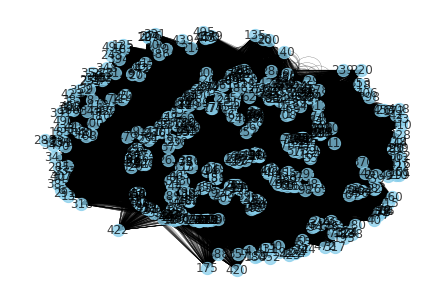

<Figure size 7200x7200 with 0 Axes>

In [5]:
import matplotlib.pyplot as plt
import networkx as nx

def show_graph_with_labels(adjacency_matrix):
    rows, cols = np.where(adjacency_matrix==1)
    edges = zip(rows.tolist(), cols.tolist())
    G = nx.Graph()
    G.add_edges_from(edges)
    pos = nx.spring_layout(G)
    nx.draw(G, pos=pos, node_size=150, with_labels=True, node_color="skyblue", width=0.25, alpha=0.75, edge_color="black")
    plt.figure(figsize=(100,100))
    plt.show()

# show_graph_with_labels(adjacency_matrix)
show_graph_with_labels(adj_m)

In [6]:
## trying to find communities within the smaller graph

from cdlib import algorithms
import networkx as nx

# rows, cols = np.where(adjacency_matrix==1)
rows, cols = np.where(adj_m==1)
edges = zip(rows.tolist(), cols.tolist())
G = nx.Graph()
G.add_edges_from(edges)

Note: to be able to use all crisp methods, you need to install some additional packages:  {'wurlitzer', 'graph_tool', 'infomap', 'karateclub'}
Note: to be able to use all overlapping methods, you need to install some additional packages:  {'ASLPAw', 'karateclub'}
Note: to be able to use all bipartite methods, you need to install some additional packages:  {'wurlitzer', 'infomap'}


In [7]:
coms = algorithms.leiden(G)

print(coms.communities)
# print(coms.to_json())

[[0, 15, 470, 296, 363], [3, 70, 440, 496, 497], [10, 44, 164, 456, 243], [12, 186, 442, 449, 114], [14, 109, 278, 101, 356], [18, 81, 354, 401, 422], [179, 389, 430, 222, 375], [312, 435, 138, 175, 285], [153, 263, 478, 166, 280], [99, 377, 414, 482, 458], [91, 488, 491, 171, 237], [17, 248, 6, 257, 284], [73, 8, 32, 367, 492], [76, 216, 9, 128, 259], [208, 228, 487, 26, 144], [41, 199, 113, 127, 200], [194, 287, 140, 346, 379], [108, 270, 369, 159, 397], [102, 384, 181, 187, 301], [1, 429, 172, 197, 348], [24, 158, 170, 96, 214], [69, 145, 499, 233, 378], [62, 64, 272, 427, 235], [71, 162, 461, 185, 273], [66, 133, 40, 147, 315], [65, 226, 451, 457, 359], [229, 98, 347, 365, 403], [21, 246, 350, 298, 394], [160, 203, 400, 425, 495], [82, 121, 493, 33, 433], [152, 219, 468, 19, 445], [92, 436, 13, 310, 448], [149, 178, 332, 124, 460], [295, 393, 103, 326, 480], [4, 165, 336], [5, 426, 148], [7, 142, 118], [11, 314, 46], [16, 405, 324], [23, 386, 465], [25, 330, 352], [27, 136, 404], [

In [8]:
coms = algorithms.louvain(G)

print(coms.communities)
# print(coms.to_json())

[[4, 351, 404, 283, 495], [7, 248, 270, 155, 166], [10, 162, 165, 433, 452], [11, 71, 412, 159, 363], [21, 260, 289, 291, 378], [27, 247, 447, 138, 448], [36, 121, 137, 348, 422], [38, 56, 358, 32, 118], [41, 231, 345, 19, 341], [48, 142, 152, 40, 365], [52, 126, 429, 148, 344], [53, 274, 398, 135, 439], [58, 112, 173, 331, 423], [64, 265, 361, 342, 346], [69, 329, 449, 200, 300], [72, 116, 424, 391, 474], [74, 149, 236, 220, 349], [75, 177, 491, 20, 277], [77, 287, 305, 311, 431], [81, 133, 230, 318, 370], [82, 216, 234, 299, 450], [84, 380, 468, 101, 122], [85, 303, 489, 168, 180], [88, 343, 438, 264, 301], [93, 100, 201, 28, 42], [99, 170, 372, 181, 214], [108, 109, 405, 483, 486], [119, 229, 390, 26, 326], [141, 278, 440, 107, 128], [164, 368, 488, 132, 257], [182, 426, 434, 353, 367], [191, 223, 496, 408, 479], [196, 215, 244, 2, 383], [281, 399, 436, 127, 477], [0, 295, 322], [1, 402, 96], [3, 457, 321], [5, 443, 492], [12, 228, 8], [14, 465, 13], [15, 268, 175], [16, 62, 415], [

In [9]:
coms = algorithms.surprise_communities(G)

print(coms.communities)
# print(coms.to_json())

[[0, 196], [1], [3], [4], [5], [7], [10], [11], [12], [14], [15], [16], [17], [18], [21], [23], [24], [25], [27], [29], [30], [31], [35], [36], [37], [38], [39], [41], [43], [44], [45], [47], [48], [49], [50], [51], [52], [53], [54], [55], [56], [57], [58], [59], [60], [61], [62], [63], [64], [65], [66], [67], [68], [69], [70], [71], [72], [73], [74], [75], [76], [77], [78], [79], [80], [81], [82], [83], [84], [85], [86], [87], [88], [89], [90], [91], [92], [93], [94], [95], [97], [99], [100], [102], [105], [106], [108], [109], [111], [112], [115], [116], [117], [119], [121], [123], [126], [129], [131], [133], [134], [136], [137], [139], [141], [142], [145], [146], [149], [150], [151], [152], [153], [154], [156], [157], [158], [160], [161], [162], [163], [164], [165], [169], [170], [173], [174], [176], [177], [178], [179], [182], [184], [186], [188], [189], [190], [191], [192], [193], [194], [199], [201], [202], [203], [206], [207], [208], [210], [211], [213], [215], [216], [219], [221

In [10]:
coms = algorithms.walktrap(G)

print(coms.communities)
# print(coms.to_json())

[[0, 1, 3, 4, 5, 7, 10, 11, 12, 14, 15, 16, 17, 18, 21, 23, 24, 25, 27, 29, 30, 31, 35, 36, 37, 38, 39, 41, 43, 44, 45, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 97, 99, 100, 102, 105, 106, 108, 109, 111, 112, 115, 116, 117, 119, 121, 123, 126, 129, 131, 133, 134, 136, 137, 139, 141, 142, 145, 146, 149, 150, 151, 152, 153, 154, 156, 157, 158, 160, 161, 162, 163, 164, 165, 169, 170, 173, 174, 176, 177, 178, 179, 182, 184, 186, 188, 189, 190, 191, 192, 193, 194, 196, 199, 201, 202, 203, 206, 207, 208, 210, 211, 213, 215, 216, 219, 221, 223, 225, 226, 227, 228, 229, 230, 231, 232, 234, 236, 238, 240, 241, 244, 245, 246, 247, 248, 249, 250, 251, 252, 253, 254, 256, 258, 260, 262, 263, 265, 266, 267, 268, 270, 271, 272, 274, 275, 276, 278, 279, 281, 282, 286, 287, 289, 290, 292, 293, 295, 297, 302, 303, 305, 308, 309, 312, 314, 316, 319, 3

In [ ]:
##############################################################################################################################

### igraph (python)

In [ ]:
# !pip install cairocffi

In [16]:
import matplotlib.pyplot as plt
import igraph as ig

rows, cols = np.where(adj_m==1)
edges = list(zip(rows.tolist(), cols.tolist()))

# print(list(edges))
# print(edges)

g = ig.Graph()
g.add_vertices(500)
g.add_edges(list(edges))

# print(g.get_adjacency())
# print(g.get_edgelist())

# layout = g.layout("kk")
# layout = g.layout("rt")
layout = g.layout("drl")
ig.plot(g, layout=layout)